## XCA images preprocessing exploration
####  X-ray coronary angiography (XCA) is a medical imaging method widely used for diagnosing and treating coronary heart disease (CHD). In recent years, the use of machine learning models, such as convolutional neural networks (CNNs) and transform-based models, for detecting pathological structures in medical images has grown, driving the development of AI-powered computer-aided detection (CAD) systems.
#### Vessel segmentation and lesion detection can be challenging, mainly due to highly noisy images, patient motion, and varying levels of contrast. Thus, image preprocessing is key to improving model training (by providing higher-quality data) and enhancing its predictions.
#### In this notebook we explore diverse filters founded in literature, oriented to XCA images preprocessing. 
###### For executing this code, the following packeges are neaded: scikit-image

### References:
#### Popov, M., Aimyshev, T., Ismailov, E., Bulegenov, A., & Fazli, S. (2022). A review of modern approaches for coronary angiography imaging analysis. arXiv preprint arXiv:2209.13997.
#### Nguyen-Tat, T. B., Hung, T. Q., Nam, P. T., & Ngo, V. M. (2025). Evaluating pre-processing and deep learning methods in medical imaging: Combined effectiveness across multiple modalities. Alexandria Engineering Journal, 119, 558-586.

In [2]:
BASE_DIR = "/home/INSA-LYON/lchiaraval/anaconda_projects/angio/miscellaneous/XCA_preprocessing"

In [3]:
%matplotlib inline
%load_ext autoreload

In [4]:
import os 
import skimage as ski
import matplotlib as mlp
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import cv2 as cv

In [5]:
from src import config
from src.utils import read_show, plot_hist, plot_filterens
from src.retinex import MSRCR
from src.hmm import HybridMedianMean

In [6]:
xca_images = []
for file in os.listdir(BASE_DIR+'/images'):
    if file.endswith(('.png')):
        img = np.asarray(Image.open(BASE_DIR+'/images/'+file).convert('RGB'))
        xca_images.append(img)

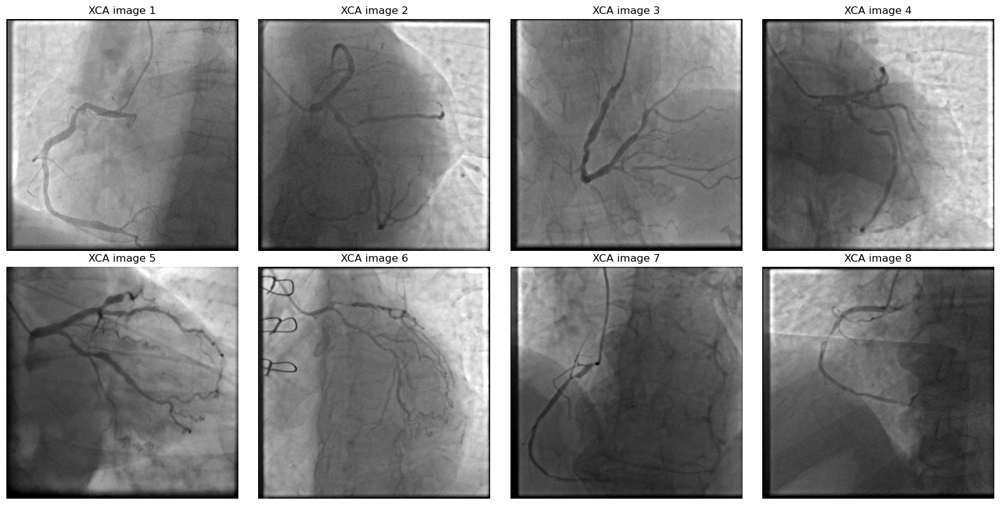

In [6]:
num_images = 8
rows, cols = 2, 4

plt.figure(figsize=(16, 8))  # Adjust size as needed

for i in range(num_images):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(xca_images[i])  # RGB assumed
    plt.axis('off')
    plt.title(f"XCA image {i+1}")

plt.tight_layout()
plt.show()

#### Multi-scale retinex

In [55]:
msrcr_img = MSRCR(xca_images[1],config.SIGMA_LIST,config.ALPHA,config.BETA,config.G,config.OFFSET)

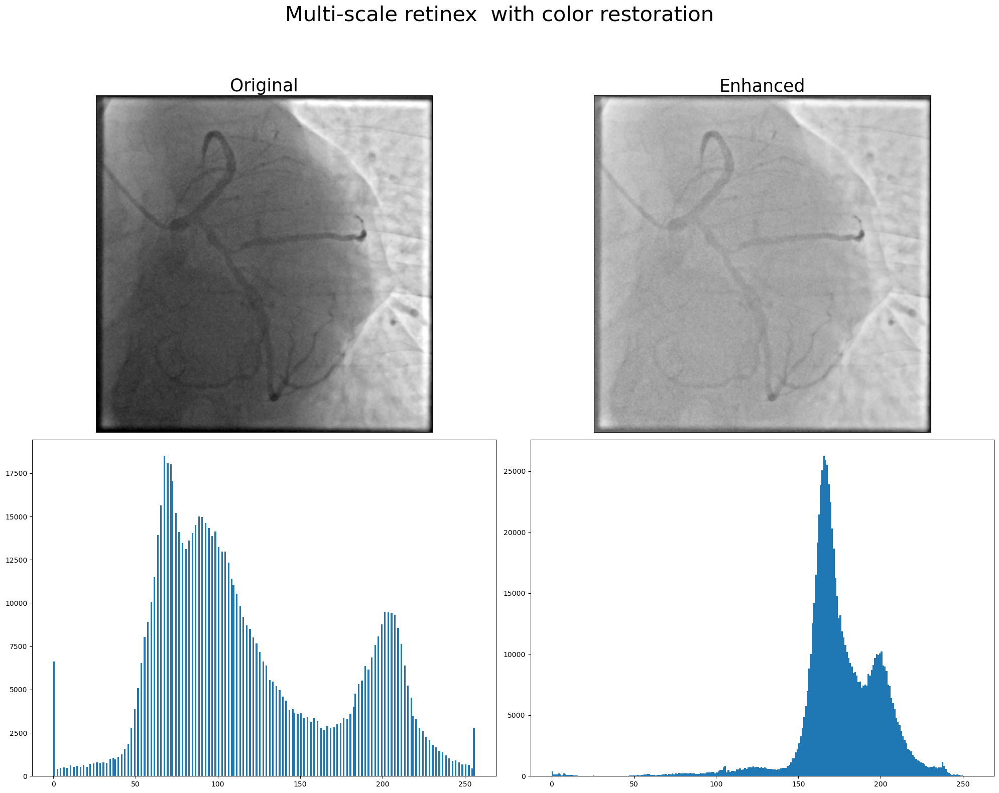

In [17]:
plot_hist(xca_images[1], msrcr_img, hist=True)
plt.show()

#### Histogram Equalization
##### https://scikit-image.org/docs/0.25.x/auto_examples/color_exposure/plot_equalize.html

In [6]:
from skimage import exposure

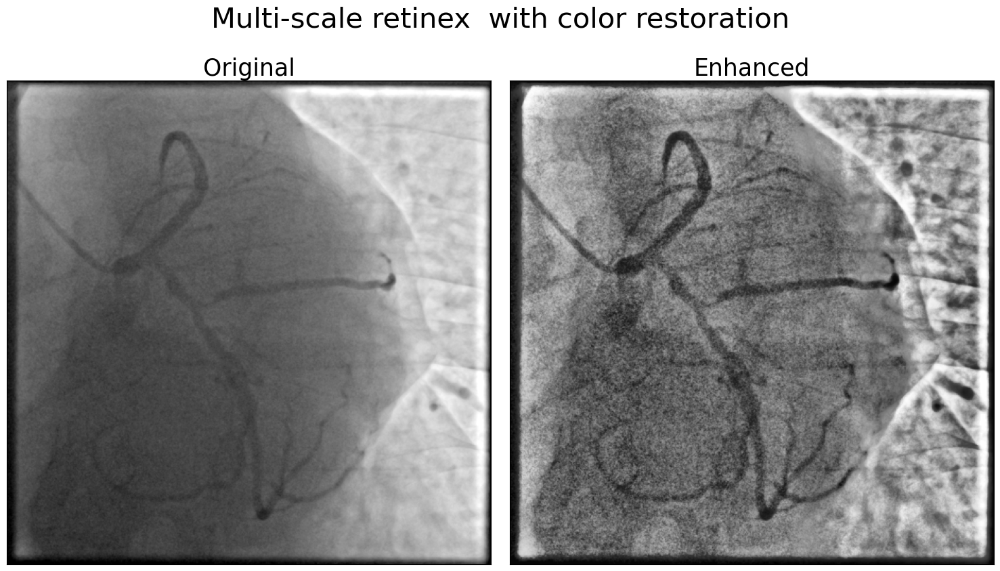

In [52]:
img_eq = exposure.equalize_adapthist(xca_images[1], clip_limit=0.03)
plot_hist(xca_images[1], img_eq, hist=False)
plt.show()

#### CLAHE

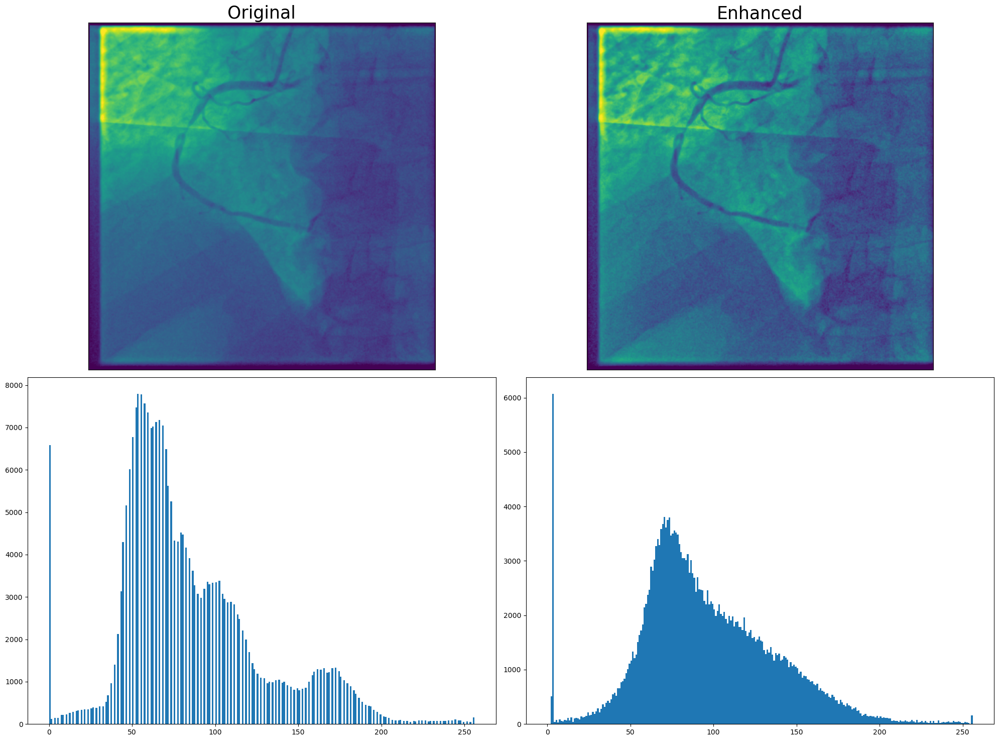

In [51]:
import numpy as np
import cv2 as cv
 
img = cv.imread(BASE_DIR+'/images/xca_01.png', cv.IMREAD_GRAYSCALE)
#assert img is not None, "file could not be read, check with os.path.exists()"
 
# create a CLAHE object (Arguments are optional).
clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
cl1 = clahe.apply(img)
plot_hist(img, cl1, hist=True)
plt.show()

#### Meijering

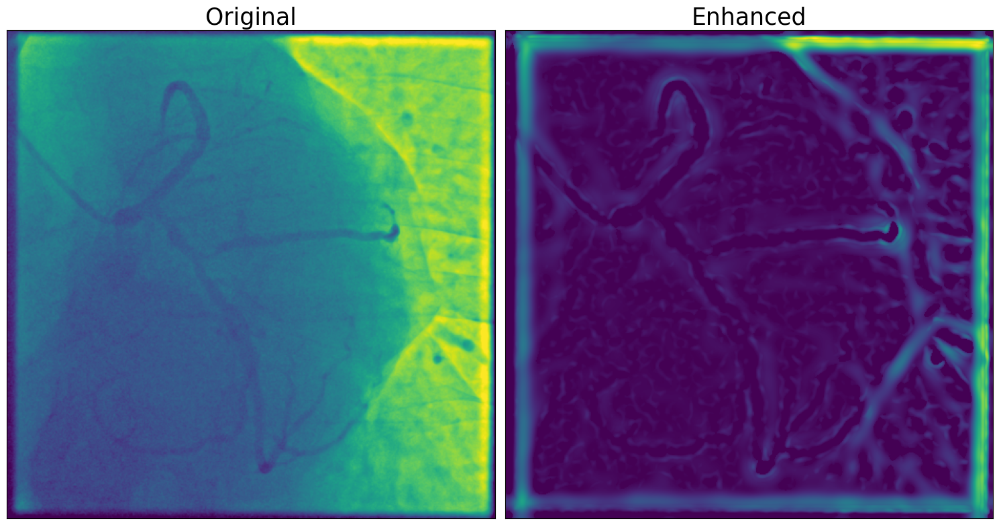

In [18]:
img_meijering = ski.filters.meijering(ski.color.rgb2gray(xca_images[1]), sigmas=[3, 6, 9], 
                                      alpha=None, black_ridges=False, mode='reflect', cval=0)
plot_hist(ski.color.rgb2gray(xca_images[1]), img_meijering, hist=False)
plt.show()

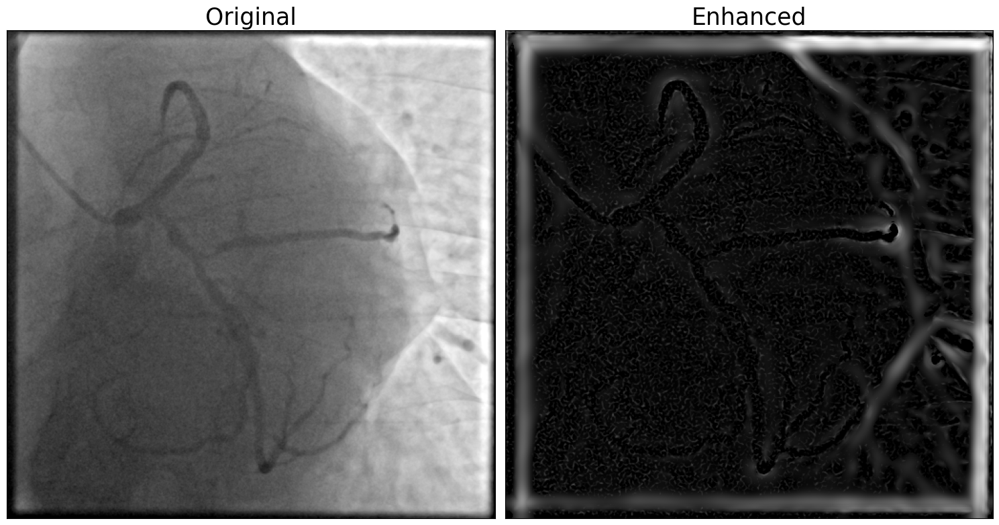

In [8]:
img_meijering = ski.filters.meijering(xca_images[1], sigmas=range(1, 10, 2), 
                                      alpha=None, black_ridges=False, mode='reflect', cval=0)
plot_hist(xca_images[1], img_meijering, hist=False)
plt.show()

#### SATO

In [16]:
# Crop the image to the specified region and convert it to grayscale
image = ski.color.rgb2gray(xca_images[1])
# Apply the Sato filter with the default values
filtered_image = ski.filters.sato(image)

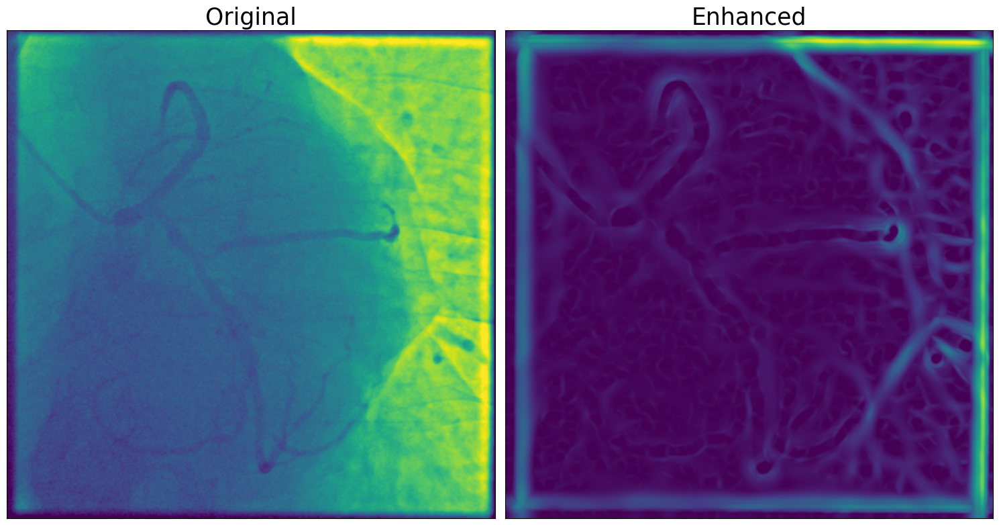

In [17]:
img_sato = ski.filters.sato(image, sigmas=[3, 6, 9], 
                            black_ridges=False, mode='reflect', cval=0)
plot_hist(image, img_sato, hist=False)
plt.show()

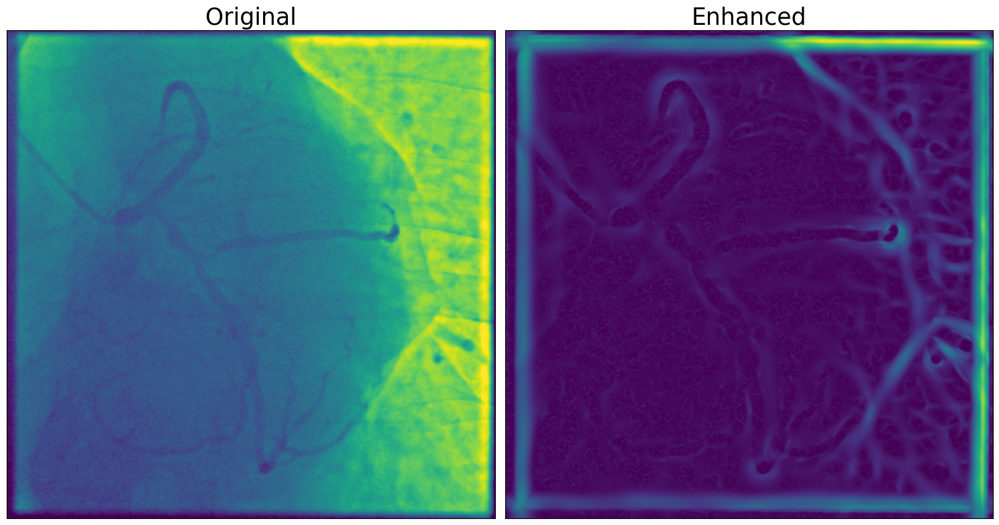

In [19]:
img_sato = ski.filters.sato(image, sigmas=[1,3, 6, 9], 
                            black_ridges=False, mode='reflect', cval=0)
plot_hist(image, img_sato, hist=False)
plt.show()

### Filters ensembles exploration

#### MSRCR + Histogram adaptibe equalizor

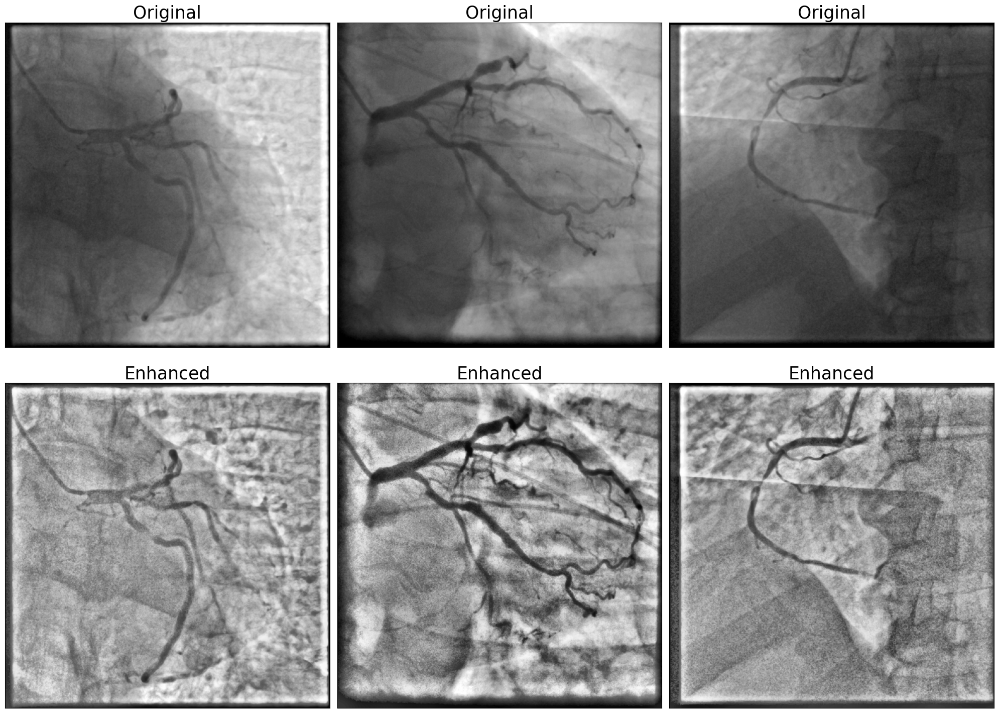

In [7]:
images = [xca_images[i] for i in [3,4,7]]
images_filterchain = []
for img in images:
    img_filterchain =  ski.exposure.equalize_adapthist(MSRCR(img,config.SIGMA_LIST,config.ALPHA,config.BETA,config.G,config.OFFSET),
                                clip_limit=0.015)
    images_filterchain.append(img_filterchain)
plot_filterens(images,images_filterchain)
plt.show()

In [8]:
enh_img_a = images_filterchain

#### CLAHE + Median Filter

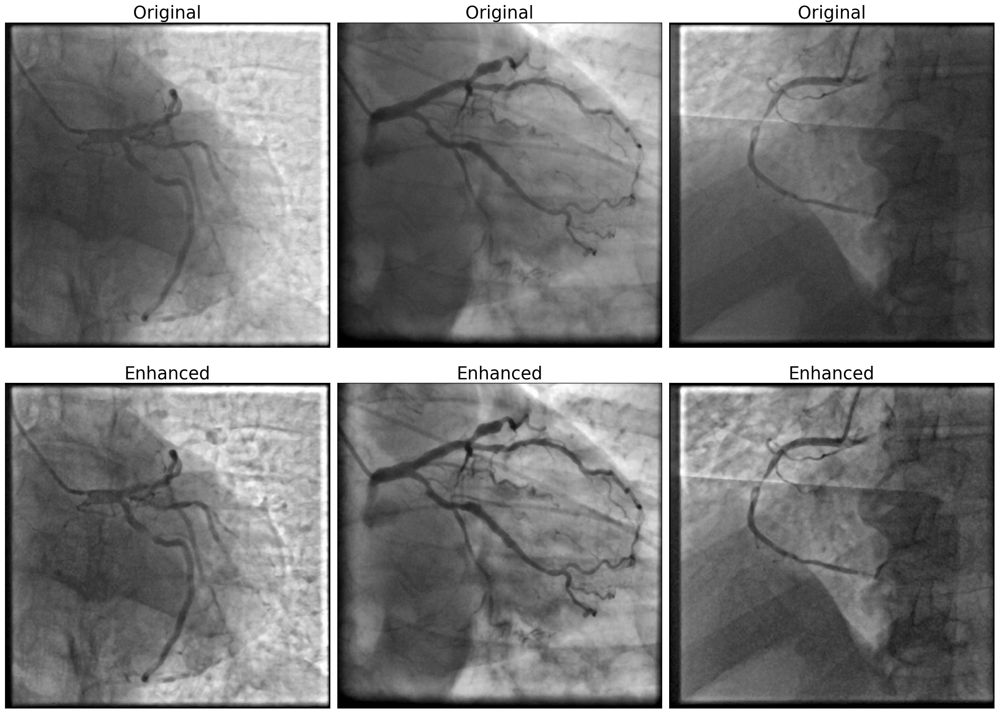

In [30]:
images = [xca_images[i] for i in [3,4,7]]
images_filterchain = []

clahe = cv.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))

for img in images:
    img_ = cv.cvtColor(img, cv.COLOR_BGR2GRAY) # Flattened image
    img_filterchain =   cv.medianBlur(clahe.apply(img_),3)
    images_filterchain.append(img_filterchain)
plot_filterens(images,images_filterchain)
plt.show()

In [31]:
enh_img_b = images_filterchain

#### MSRCR + Unsharp masking

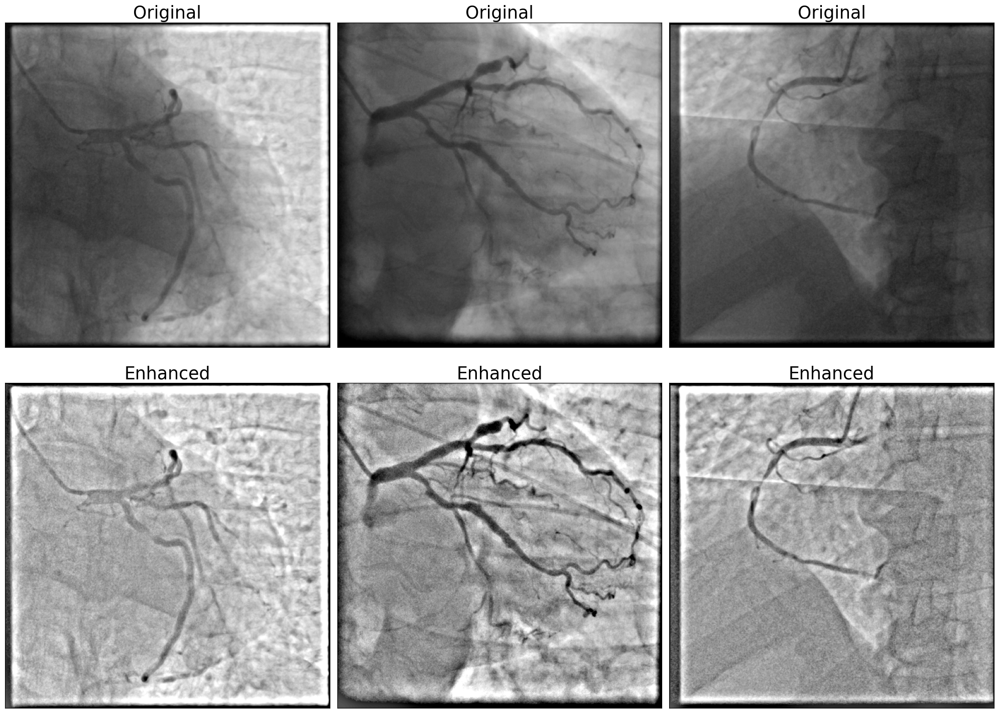

In [12]:
images = [xca_images[i] for i in [3,4,7]]
images_filterchain = []
for img in images:
    img_filterchain =  ski.filters.unsharp_mask(MSRCR(img,config.SIGMA_LIST,config.ALPHA,config.BETA,config.G,config.OFFSET),
                                radius=10, amount=2)
    images_filterchain.append(img_filterchain)
plot_filterens(images,images_filterchain)
plt.show()

In [13]:
enh_img_c = images_filterchain

#### Unsharp masking + bilateral filter

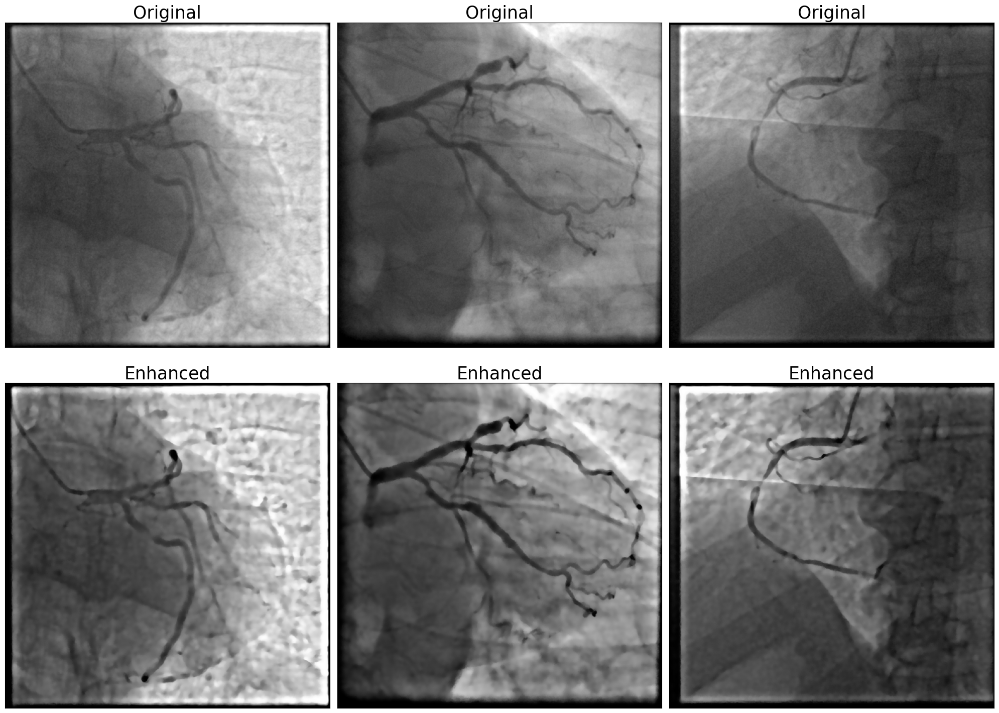

In [34]:
images = [xca_images[i] for i in [3,4,7]]
images_filterchain = []
for img in images:
    img_ =  ski.filters.unsharp_mask(img, radius=10, amount=1.5)
    img_filterchain = cv.bilateralFilter(cv.normalize(img_, None, 0, 255, cv.NORM_MINMAX).astype('uint8'),9,75,75)
    images_filterchain.append(img_filterchain)
plot_filterens(images,images_filterchain)
plt.show()

#### MSRCR + Unsharp masking + bilateral filter

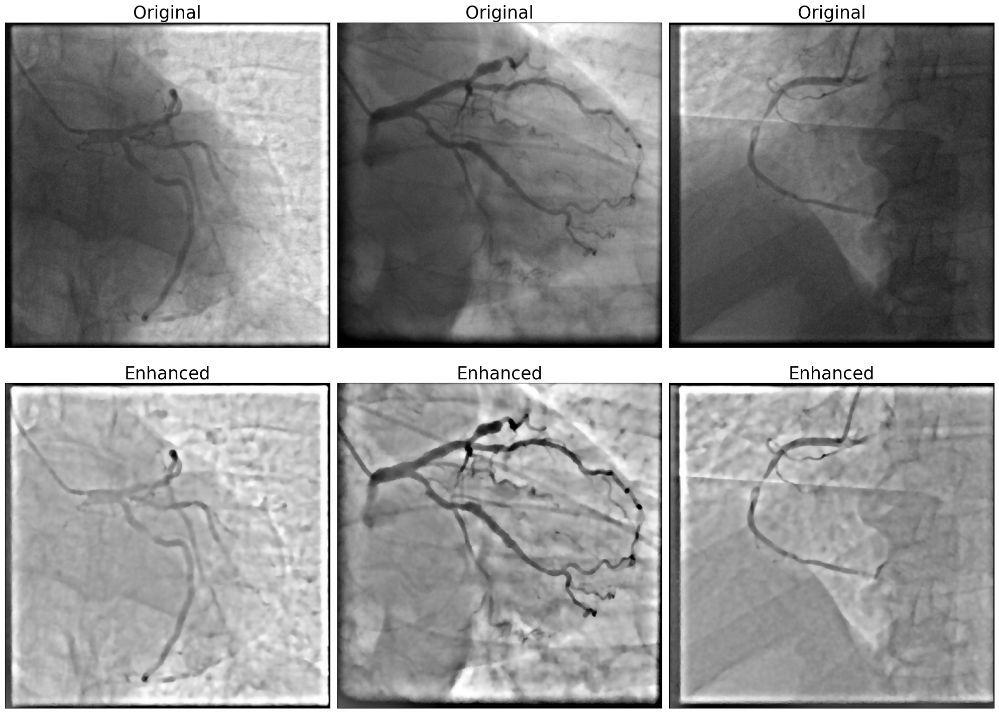

In [14]:
images = [xca_images[i] for i in [3,4,7]]
images_filterchain = []
for img in images:
    img_ =  ski.filters.unsharp_mask(MSRCR(img,config.SIGMA_LIST,config.ALPHA,config.BETA,config.G,config.OFFSET),
                                    radius=10, amount=1.5)
    img_filterchain = cv.bilateralFilter(cv.normalize(img_, None, 0, 255, cv.NORM_MINMAX).astype('uint8'),9,75,75)
    images_filterchain.append(img_filterchain)
plot_filterens(images,images_filterchain)
plt.show()

In [15]:
enh_img_d = images_filterchain

#### Hybrid Median-mean

In [ ]:
images = [xca_images[i] for i in [3,4,7]]
HybridMedianMean(cv.cvtColor(images[0], cv.COLOR_BGR2GRAY), 3 , 
                 figures='False', plots ='False', save_image='False')

### Filters comparison

In [37]:
def plot_filcomp(orig_img, enh_img_a, enh_img_b, enh_img_c, enh_img_d): 
    fig, ax = plt.subplots(3,5, figsize=(20,15))

    ax[0,0].imshow(orig_img[0])
    ax[0,0].set_xticks([])
    ax[0,0].set_yticks([])
    ax[0,0].set_title('Original',fontsize=18)
    ax[1,0].imshow(orig_img[1], cmap='gray')
    ax[1,0].set_xticks([])
    ax[1,0].set_yticks([])
    ax[1,0].set_title('',fontsize=25)
    ax[2,0].imshow(orig_img[2], cmap='gray')
    ax[2,0].set_xticks([])
    ax[2,0].set_yticks([])
    ax[2,0].set_title('',fontsize=25)


    ax[0,1].imshow(enh_img_a[0], cmap='gray')
    ax[0,1].set_xticks([])
    ax[0,1].set_yticks([])
    ax[0,1].set_title('MSRCR + Histogram equalizor',fontsize=18)
    ax[1,1].imshow(enh_img_a[1], cmap='gray')
    ax[1,1].set_xticks([])
    ax[1,1].set_yticks([])
    ax[1,1].set_title('',fontsize=25)
    ax[2,1].imshow(enh_img_a[2], cmap='gray')
    ax[2,1].set_xticks([])
    ax[2,1].set_yticks([])
    ax[2,1].set_title('',fontsize=10)

    ax[0,2].imshow(enh_img_b[0], cmap='gray')
    ax[0,2].set_xticks([])
    ax[0,2].set_yticks([])
    ax[0,2].set_title('CLAHE + Median Filter',fontsize=18)
    ax[1,2].imshow(enh_img_b[1], cmap='gray')
    ax[1,2].set_xticks([])
    ax[1,2].set_yticks([])
    ax[1,2].set_title('',fontsize=25)
    ax[2,2].imshow(enh_img_b[2], cmap='gray')
    ax[2,2].set_xticks([])
    ax[2,2].set_yticks([])
    ax[2,2].set_title('',fontsize=15)

    ax[0,3].imshow(enh_img_c[0], cmap='gray')
    ax[0,3].set_xticks([])
    ax[0,3].set_yticks([])
    ax[0,3].set_title('MSRCR + Unsharp masking',fontsize=18)
    ax[1,3].imshow(enh_img_c[1], cmap='gray')
    ax[1,3].set_xticks([])
    ax[1,3].set_yticks([])
    ax[1,3].set_title('',fontsize=25)
    ax[2,3].imshow(enh_img_c[2], cmap='gray')
    ax[2,3].set_xticks([])
    ax[2,3].set_yticks([])
    ax[2,3].set_title('',fontsize=10)

    ax[0,4].imshow(enh_img_d[0], cmap='gray')
    ax[0,4].set_xticks([])
    ax[0,4].set_yticks([])
    ax[0,4].set_title('MSRCR + Unsharp masking + Bilateral Filter',fontsize=10)
    ax[1,4].imshow(enh_img_d[1], cmap='gray')
    ax[1,4].set_xticks([])
    ax[1,4].set_yticks([])
    ax[1,4].set_title('',fontsize=25)
    ax[2,4].imshow(enh_img_d[2], cmap='gray')
    ax[2,4].set_xticks([])
    ax[2,4].set_yticks([])
    ax[2,4].set_title('',fontsize=10)

    fig.suptitle('', fontsize=30, y=1.05)
    fig.tight_layout()

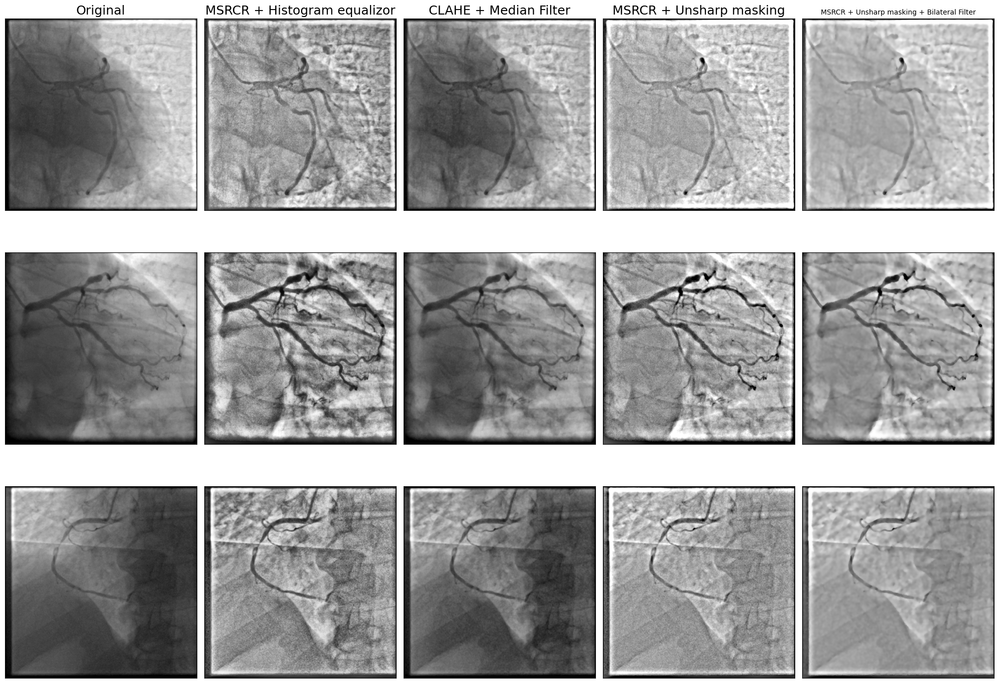

In [38]:
plot_filcomp(images, enh_img_a, enh_img_b, enh_img_c, enh_img_d )
plt.show()